### Imports

In [32]:
%matplotlib inline

import matplotlib.pyplot as plt
import seaborn
import librosa
import librosa.display
from IPython.display import Audio
import numpy as np
import scipy
import sklearn
import os, requests

### Get Our 10 90's West Coast songs

In [33]:
# 1 minute chunk of each song offset by 1 minute.

x1, sr1 = librosa.load("songs/Bad and Boujee.mp3",duration=60,offset=60)
x2, sr2 = librosa.load("songs/Digits.mp3",duration=60,offset=60)
x3, sr3 = librosa.load("songs/Drip or Drown.mp3",duration=60,offset=60)
x4, sr4 = librosa.load("songs/Everyday.mp3",duration=60,offset=60)
x5, sr5 = librosa.load("songs/I Get The Bag.mp3",duration=60,offset=60)
x6, sr6 = librosa.load("songs/Lucid Dreams.mp3",duration=60,offset=60)
x7, sr7 = librosa.load("songs/No Heart.mp3",duration=60,offset=60)
x8, sr8 = librosa.load("songs/Since When.mp3",duration=60,offset=60)
x9, sr9 = librosa.load("songs/wokeuplikethis.mp3",duration=60,offset=60)
x10, sr10 = librosa.load("songs/Work Out.mp3",duration=60,offset=60)

/Users/jaskaranpalsingh/Library/Python/3.6/lib/python/site-packages/librosa/core/audio.py:161: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn('PySoundFile failed. Trying audioread instead.')
/Users/jaskaranpalsingh/Library/Python/3.6/lib/python/site-packages/librosa/core/audio.py:161: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn('PySoundFile failed. Trying audioread instead.')
/Users/jaskaranpalsingh/Library/Python/3.6/lib/python/site-packages/librosa/core/audio.py:161: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn('PySoundFile failed. Trying audioread instead.')
/Users/jaskaranpalsingh/Library/Python/3.6/lib/python/site-packages/librosa/core/audio.py:161: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn('PySoundFile failed. Trying audioread instead.')
/Users/jaskaranpalsingh/Library/Python/3.6/lib/python/site-packages/librosa/core/audio.py:161: UserWarning: PySoundFile fail

#### Organize songs into list

In [34]:
songs = [(x1,sr1,'Bad and Boujee'),(x2,sr2,'Digits'),(x3,sr3,'Drip or Drown'),(x4,sr4,'Everyday'),(x5,sr5,'I Get The Bag'),(x6,sr6,'Lucid Dreams'),(x7,sr7,'No Heart'),(x8,sr8,'Since When'),(x9,sr9,'wokeuplikethis'),(x10,sr10,'Work Out')]

## Songs:
##### Uncomment to listen

#### "Bad and Boujee"

In [35]:
#Audio(x1,rate=sr1)

#### "Digits"

In [36]:
#Audio(x2,rate=sr2)

#### "Drip Or Drown"

In [37]:
#Audio(x3,rate=sr3)

#### "Everyday"

In [38]:
#Audio(x4,rate=sr4)

#### "I Get The Bag"

In [39]:
#Audio(x5,rate=sr5)

#### "Lucid Dreams"

In [40]:
#Audio(x6,rate=sr6)

#### "No Heart"

In [41]:
#Audio(x7,rate=sr7)

#### "Since When"

In [42]:
#Audio(x8,rate=sr8)

#### wokeuplikethis

In [43]:
#Audio(x9,rate=sr9)

#### "Work Out"

In [44]:
#Audio(x10,rate=sr10)

## Wave Plots

Bad and Boujee:


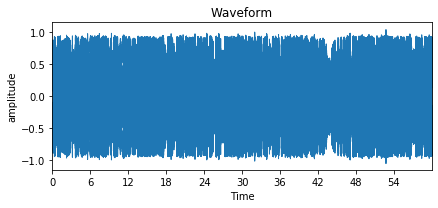

Digits:


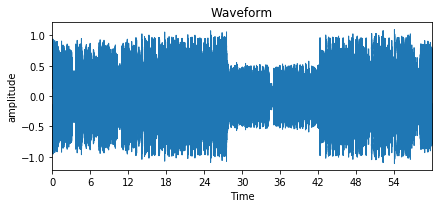

Drip or Drown:


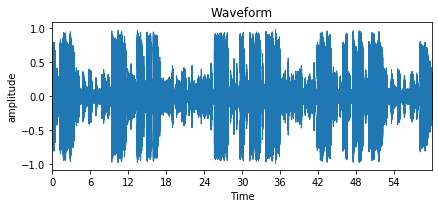

Everyday:


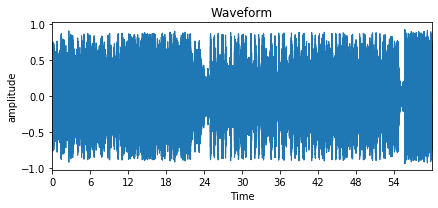

I Get The Bag:


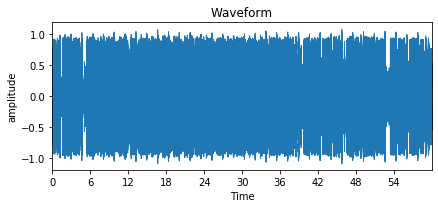

Lucid Dreams:


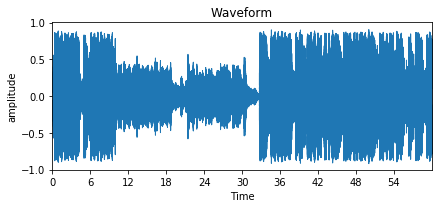

No Heart:


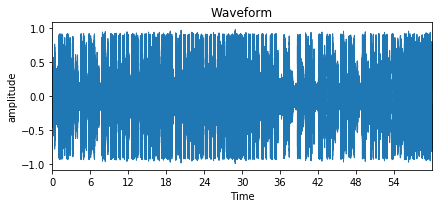

Since When:


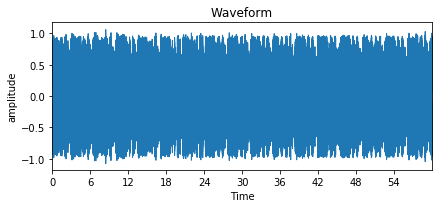

wokeuplikethis:


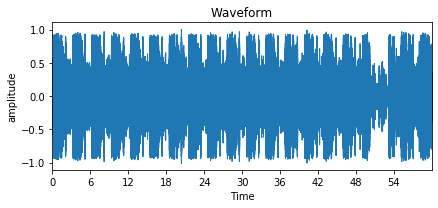

Work Out:


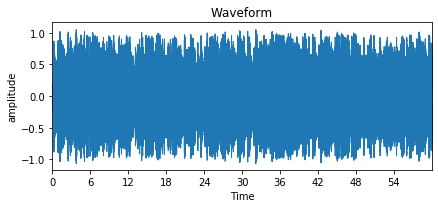

In [45]:
for song in songs:
    x = song[0]
    sr = song[1]
    plt.figure(figsize=(6,3))
    librosa.display.waveplot(x, sr=sr)
    plt.title('Waveform')
    plt.tight_layout()
    plt.ylabel("amplitude")
    print(song[2]+":")
    plt.show()

## Fourier Transform
### With top notes

Bad and Boujee:
Top Note: D#1


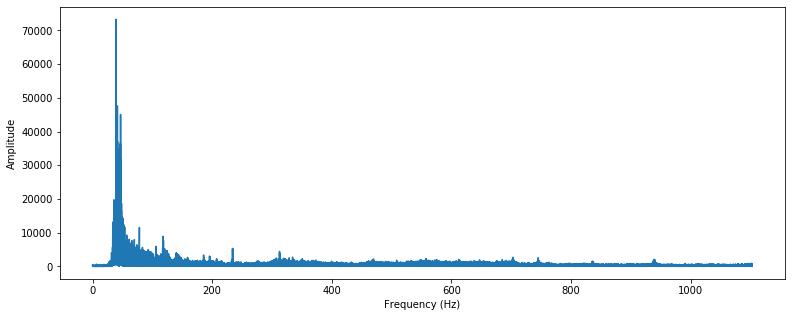

Digits:
Top Note: F1


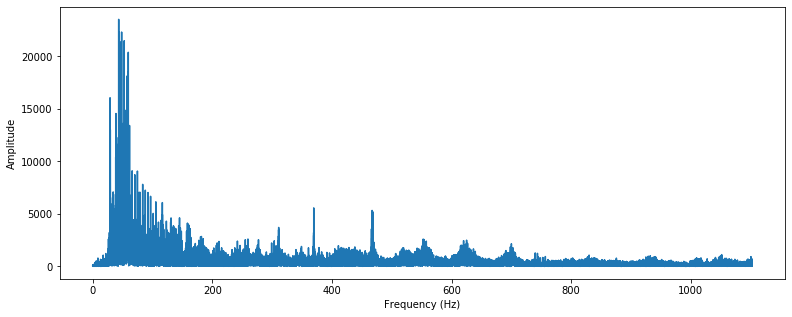

Drip or Drown:
Top Note: F1


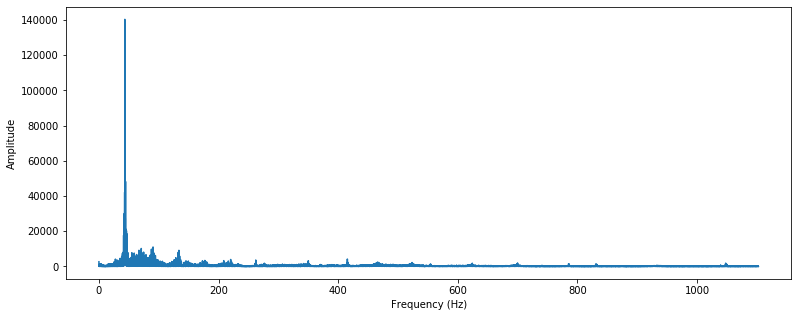

Everyday:
Top Note: F10


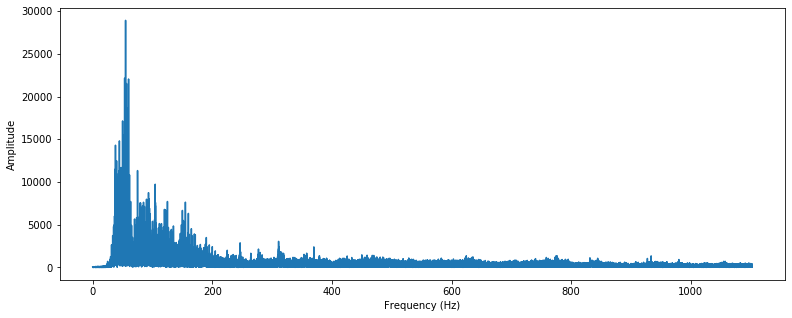

I Get The Bag:
Top Note: D#1


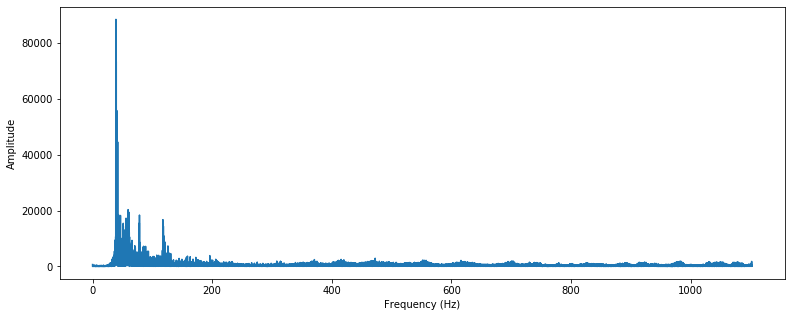

Lucid Dreams:
Top Note: D1


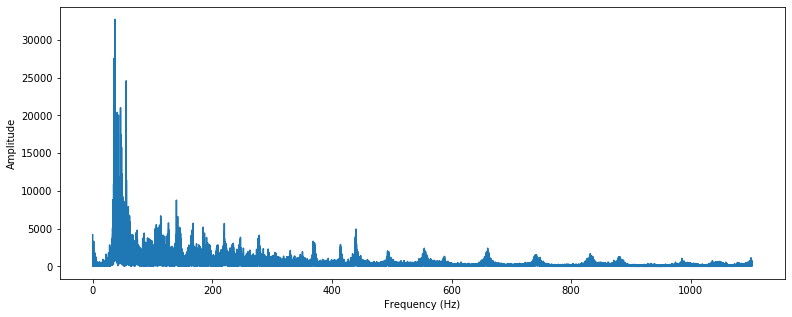

No Heart:
Top Note: A1


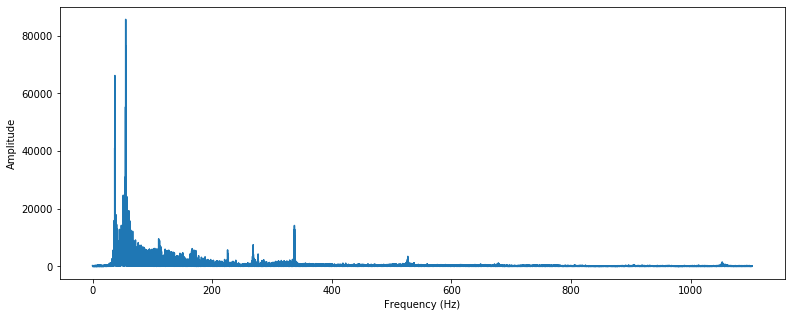

Since When:
Top Note: F10


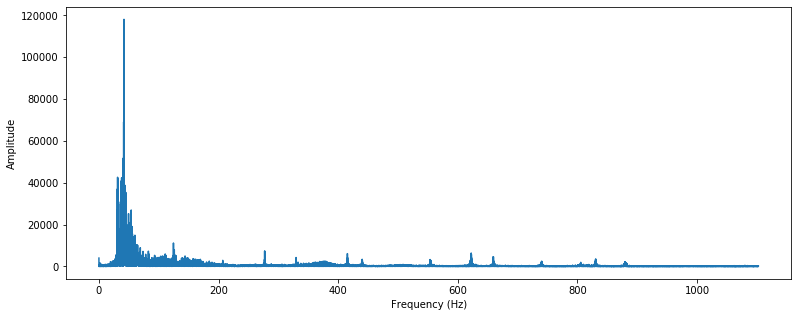

wokeuplikethis:
Top Note: F10


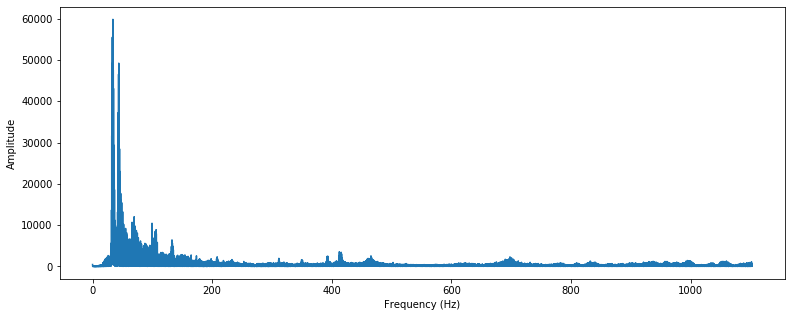

Work Out:
Top Note: D#1


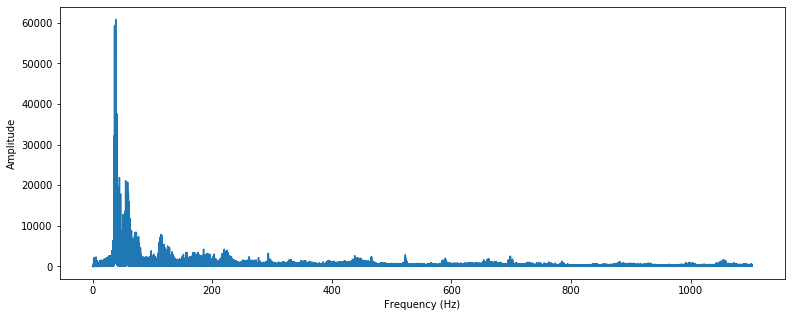

In [50]:
#fourier transform for each song
for song in songs:
    x = song[0]
    sr = song[1]
    X = scipy.fft(x)
    X_mag = np.absolute(X)
    # frequency variable
    f = np.linspace(0, sr, len(X_mag))
    plt.figure(figsize=(13, 5))
    #get closer chunk of peak (up to 5% of length of f)
    plt.plot(f[:66150], X_mag[:66150])
    plt.xlabel('Frequency (Hz)')
    plt.ylabel('Amplitude')
    #name of each song
    print(song[2]+':')
    max_pos = X_mag.argmax()
    #print the top note for each song
    print('Top Note: ' + librosa.hz_to_note(f[max_pos]))
    plt.show()

## Chroma

Bad and Boujee:


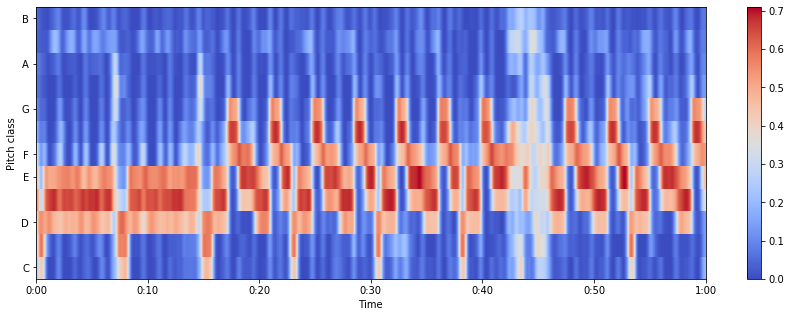

Digits:


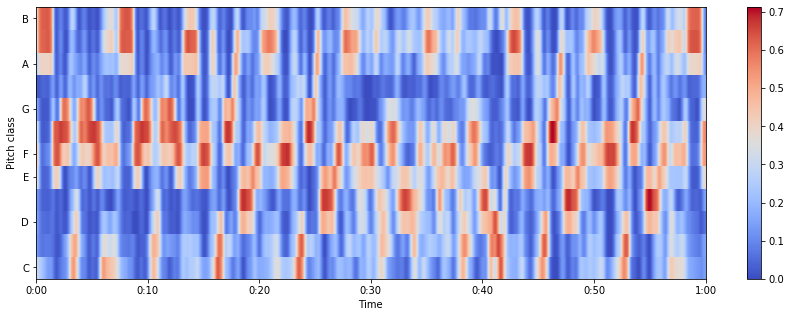

Drip or Drown:


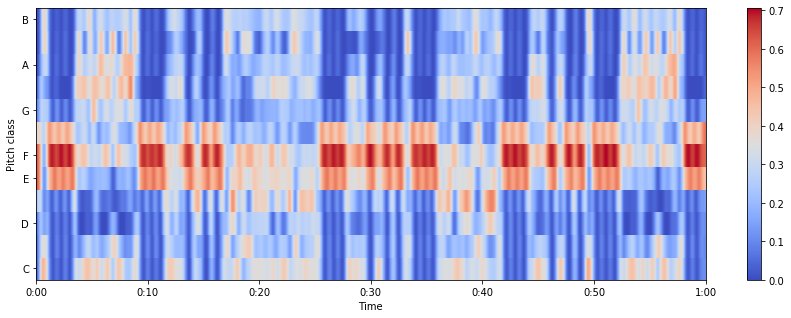

Everyday:


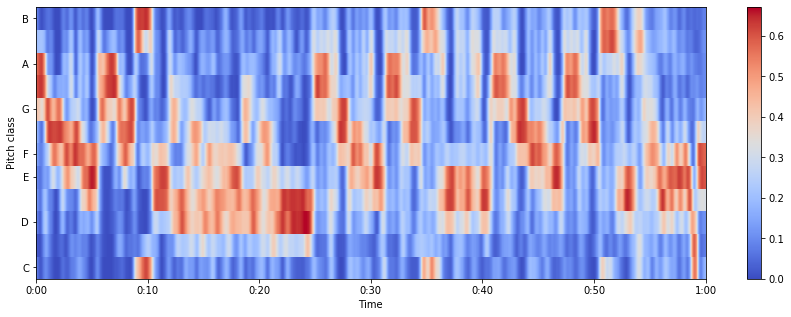

I Get The Bag:


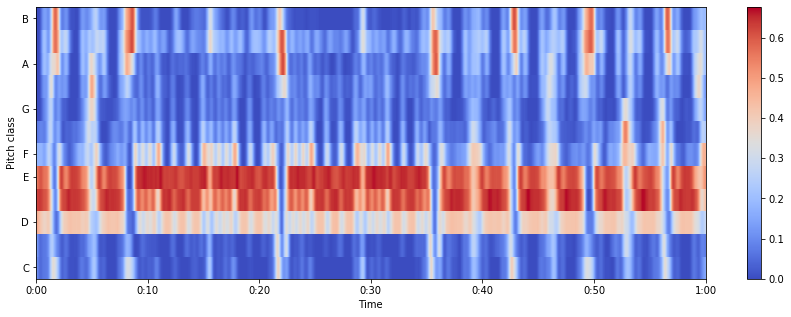

Lucid Dreams:


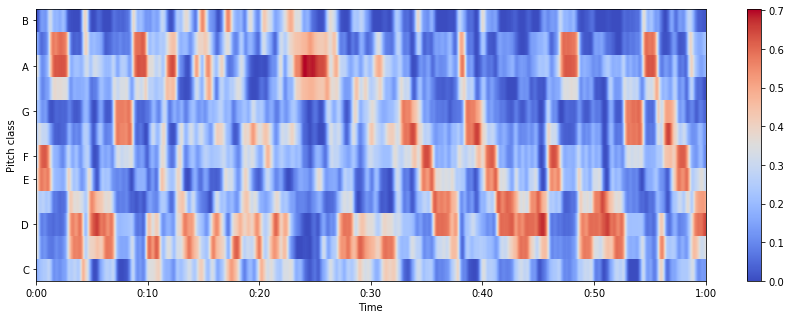

No Heart:


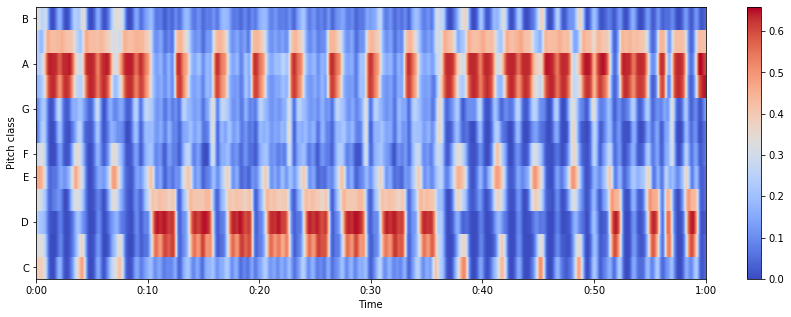

Since When:


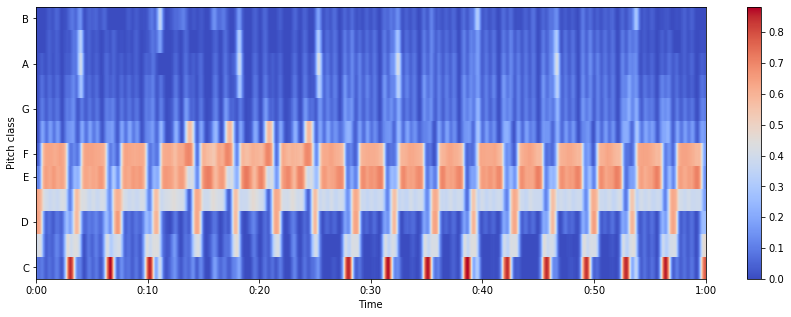

wokeuplikethis:


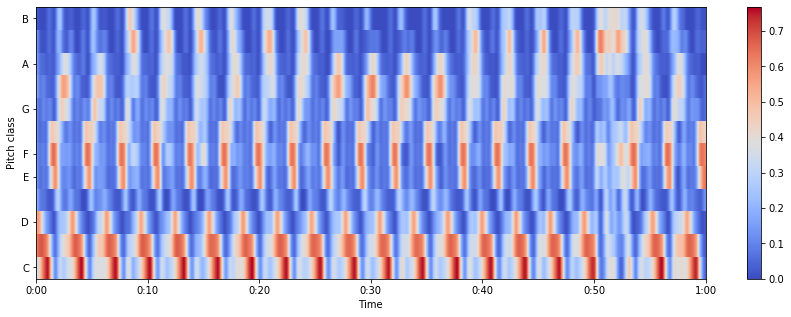

Work Out:


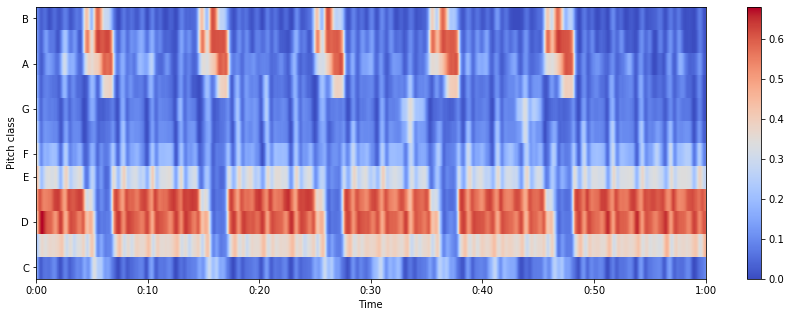

In [51]:
#calculate the chroma graph for each song
for song in songs:
    x = song[0]
    sr = song[1]
    chromagram = librosa.feature.chroma_cens(x, sr=sr, hop_length=512)
    plt.figure(figsize=(15, 5))
    librosa.display.specshow(chromagram, x_axis='time', y_axis='chroma', hop_length=512, cmap='coolwarm')
    print(song[2]+":")
    plt.colorbar()
    plt.show()

## Zero Crossing

In [52]:
#calculate the total number of zero crossings for each song
for song in songs:
    x = song[0]
    print(song[2]+':')
    print('Total # of Zero Crossings: '+ str(sum(librosa.zero_crossings(x, pad=False)))+'\n')

Bad and Boujee:
Total # of Zero Crossings: 75168

Digits:
Total # of Zero Crossings: 100676

Drip or Drown:
Total # of Zero Crossings: 71074

Everyday:
Total # of Zero Crossings: 89572

I Get The Bag:
Total # of Zero Crossings: 74092

Lucid Dreams:
Total # of Zero Crossings: 80561

No Heart:
Total # of Zero Crossings: 83457

Since When:
Total # of Zero Crossings: 50833

wokeuplikethis:
Total # of Zero Crossings: 154167

Work Out:
Total # of Zero Crossings: 57818



## Spectrogram

Bad and Boujee:


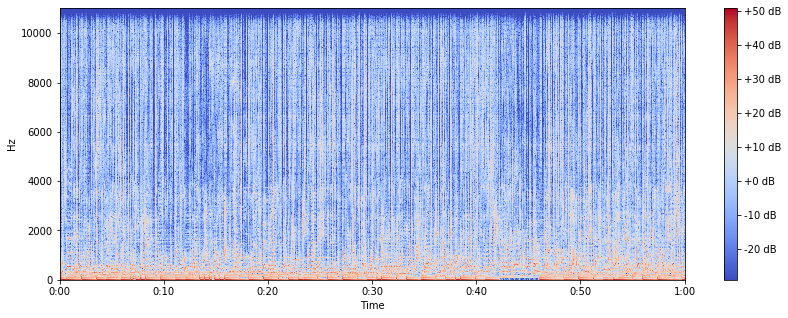

Digits:


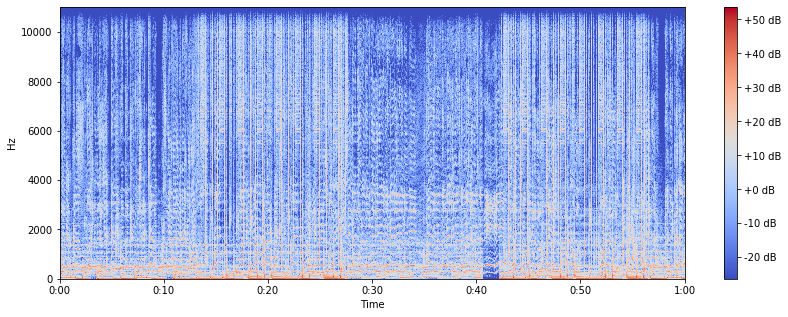

Drip or Drown:


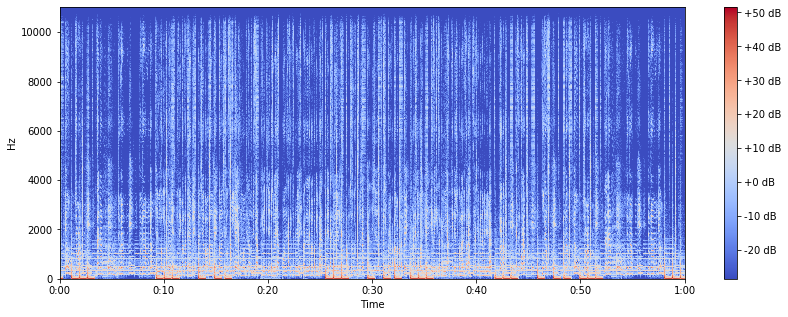

Everyday:


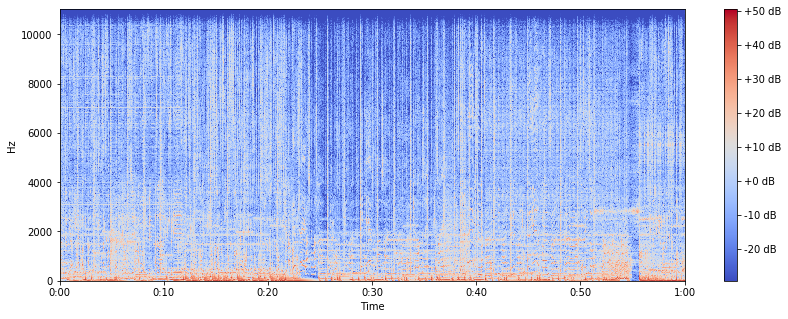

I Get The Bag:


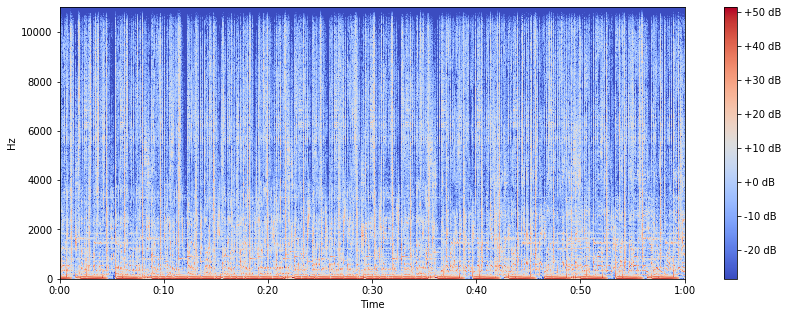

Lucid Dreams:


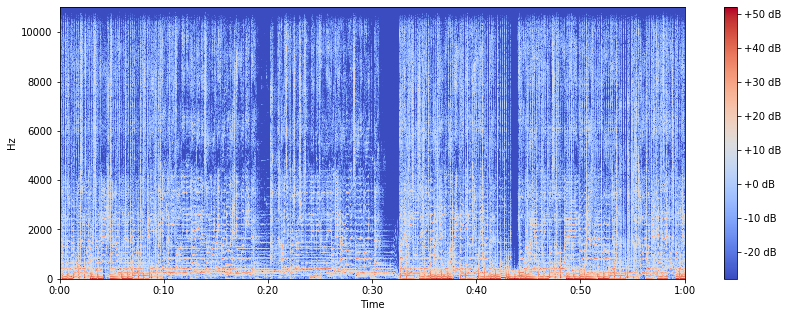

No Heart:


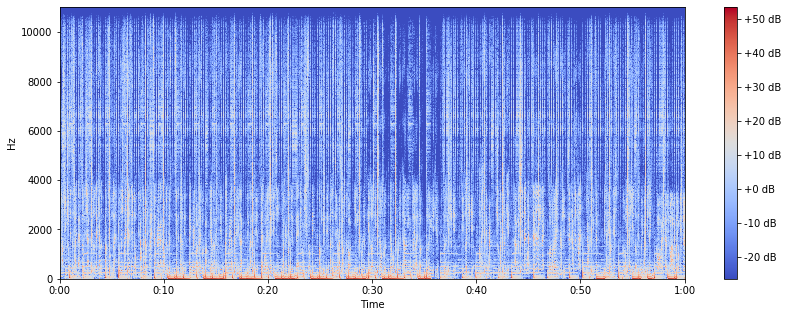

Since When:


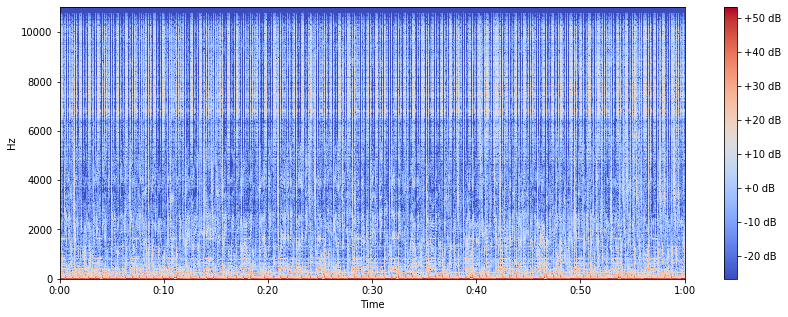

wokeuplikethis:


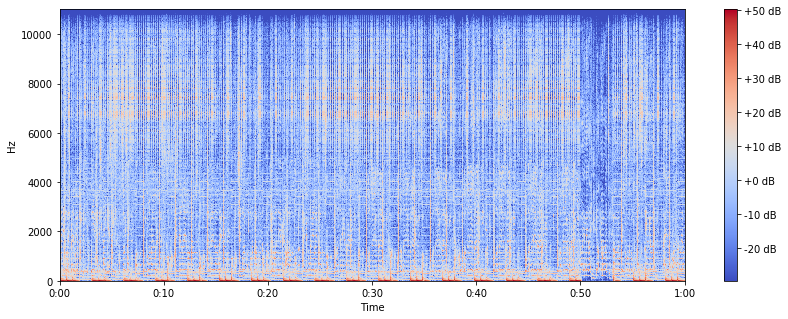

Work Out:


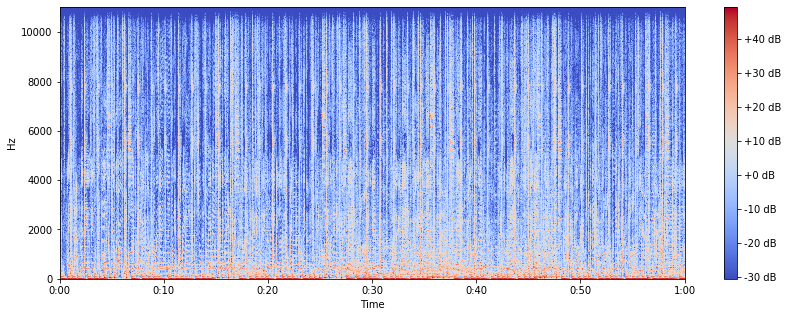

In [53]:
#spectogram for each song
for song in songs:
    x = song[0]
    sr = song[1]
    X = librosa.stft(x)
    Xdb = librosa.amplitude_to_db(abs(X))
    plt.figure(figsize=(14, 5))
    librosa.display.specshow(Xdb, sr=sr, x_axis='time', y_axis='hz')
    print(song[2]+':')
    #color bar showing intensity
    plt.colorbar(format='%+2.0f dB')
    plt.show()